# PYTORCH DOCUMENTATION
https://pytorch.org/tutorials/intermediate/torchvision_tutorial.html#defining-the-dataset

# TORCHMETRIC DOCUMENTATION
https://lightning.ai/docs/torchmetrics/stable/pages/implement.html

In [ ]:
! pip install torchmetrics

In [ ]:
import pathlib

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms, models, tv_tensors
from torchvision.transforms import v2
from torch.autograd import Variable
from torchvision.utils import save_image
from torch.optim.lr_scheduler import StepLR
import torchvision.utils as vutils
from torch.utils.data import DataLoader, TensorDataset

import matplotlib.pyplot as plt
import matplotlib.animation as animation

from IPython.display import HTML

import numpy as np

from scipy import linalg
from scipy.stats import entropy

import cv2

In [ ]:
# ARABIDOPSIS & BEAN MSU-PID DATASET
# MODALITIES: DEPTH, DEPTHSIGMA (DEPTH STD DEVIATION), FMP FLUORESCENCE, IR(INFRARED), RGB
!wget -q -N http://www.cse.msu.edu/computervision/MVA15-MSU-PID.zip
!unzip -q -n /content/MVA15-MSU-PID.zip

# KOMATSUNA
# MODALITIES: DEPTH, RGB
#!wget -q -N https://limu.ait.kyushu-u.ac.jp/~agri/komatsuna/rgbd_plant.zip
#!wget -q -N https://limu.ait.kyushu-u.ac.jp/~agri/komatsuna/rgbd_label.zip
#!unzip -q -n /content/rgbd_plant.zip
#!unzip -q -n /content/rgbd_label.zip

# Data Visualization

In [ ]:
def create_frames(plant_ids, day_ids, time_ids, modal_fstrs, width=200, height=200):
    img_list = []
    for did in day_ids:
        for tid in time_ids:
            timeslice = None
            for pid in plant_ids:
                modal_ims = None
                for fstr in modal_fstrs:
                    modal_im = cv2.imread(fstr.format(pid=pid, did=did, tid=tid))
                    W,H,C = modal_im.shape
                    m = min(W,H)
                    modal_im = modal_im[:m,:m,:C]
                    modal_im = cv2.resize(modal_im, (width,height))
                    if modal_ims is None:
                      modal_ims = modal_im
                    else:
                      modal_ims = np.vstack((modal_ims, modal_im))
                if timeslice is None:
                  timeslice = modal_ims
                else:
                  timeslice = np.hstack((timeslice, modal_ims))
            img_list.append(timeslice)
    return img_list

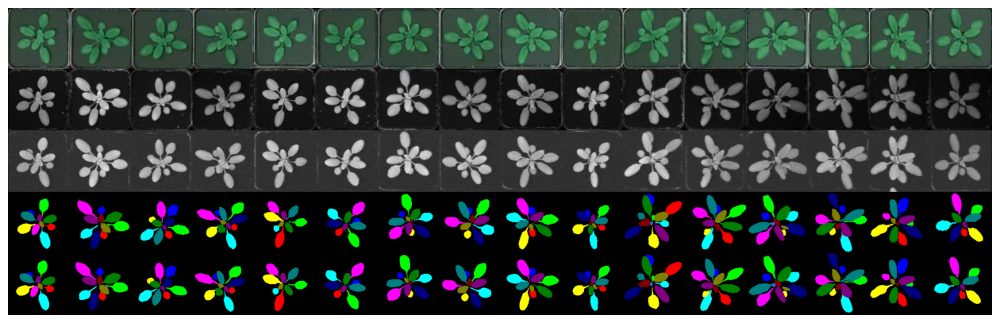

In [ ]:
# ALL LABELED ARABIDOPSIS TIME STEPPED DATA VISUALIZATION

plant_ids = [i for i in range(1,17)]
day_ids = [i for i in range(1,9)]
time_ids = [9,12,16,20] # labeled
full_time_range = [i for i in range(9,24)]

rgb_f = "/content/Release/Dataset/Images/Arabidopsis/plant_{pid}/plant_{pid}_day_{did}_hour_{tid}_rgb.png"
ir_f = "/content/Release/Dataset/Images/Arabidopsis/plant_{pid}/plant_{pid}_day_{did}_hour_{tid}_ir.png"
fmp_f = "/content/Release/Dataset/Images/Arabidopsis/plant_{pid}/plant_{pid}_day_{did}_hour_{tid}_fmp.png"
depth_f = "/content/Release/Dataset/Images/Arabidopsis/plant_{pid}/plant_{pid}_day_{did}_hour_{tid}_depth.png"
rgb_label_f = "/content/Release/Dataset/Labels/Arabidopsis/plant_{pid}/plant_{pid}_day_{did}_hour_{tid}_label_rgb.png"
fmp_label_f = "/content/Release/Dataset/Labels/Arabidopsis/plant_{pid}/plant_{pid}_day_{did}_hour_{tid}_label_fmp.png"

img_list = create_frames(plant_ids, day_ids, time_ids, [rgb_f, ir_f, fmp_f, rgb_label_f, fmp_label_f])

fig = plt.figure(figsize=(16,8))
plt.axis("off")
ims = [[plt.imshow(i, animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=500, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [ ]:
# ALL LABELED BEAN TIME STEPPED DATA VISUALIZATION

plant_ids = [i for i in range(1,6)]
day_ids = [i for i in range(1,6)]
time_ids = [9,11,13,15,17,19,21]

rgb_f = "/content/Release/Dataset/Images/Bean/plant_{pid}/plant_{pid}_day_{did}_hour_{tid}_rgb.png"
ir_f = "/content/Release/Dataset/Images/Bean/plant_{pid}/plant_{pid}_day_{did}_hour_{tid}_ir.png"
fmp_f = "/content/Release/Dataset/Images/Bean/plant_{pid}/plant_{pid}_day_{did}_hour_{tid}_fmp.png"
label_f = "/content/Release/Dataset/Labels/Bean/plant_{pid}/plant_{pid}_day_{did}_hour_{tid}_label_fmp.png"

img_list = create_frames(plant_ids, day_ids, time_ids, [rgb_f, ir_f, fmp_f, label_f], width=450, height=450)
fig = plt.figure(figsize=(10,8))
plt.axis("off")
ims = [[plt.imshow(i, animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=500, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

# Custom MSUPID Dataset Class

In [ ]:
import os
import torch
import glob
import random
from torchvision.io import read_image
from torchvision.ops.boxes import masks_to_boxes
from torchvision import tv_tensors
from torchvision.transforms.v2 import functional as F

class MSUPIDDataset(torch.utils.data.Dataset):

    def __init__(self, root, modals=['rgb','ir','fmp'], validate=False):
        self.root = root
        self.validate = validate
        self.modals = modals
        # load all image files, sorting them to
        # ensure that they are aligned

        plant_ids = [i for i in range(1,17)]
        day_ids = [i for i in range(1,9)]
        time_ids = [9,12,16,20]

        main_modal = modals[0]
        modal_f = "/content/Release/Dataset/Images/Arabidopsis/plant_{pid}/plant_{pid}_day_{did}_hour_{tid}_{modal}.png"
        label_f = "{root}Release/Dataset/Labels/Arabidopsis/plant_{pid}/plant_{pid}_day_{did}_hour_{tid}_label_{main_modal}.png"

        input_tensors = [
            self.combine_images_into_tensor([
                modal_f.format(root=root, pid=pid, did=did, tid=tid, modal=modal)
                for modal in modals
            ])
            for pid in plant_ids
            for did in day_ids
            for tid in time_ids
        ]

        if main_modal in ('ir','fmp'): main_modal = 'fmp'
        masks = [label_f.format(root=root, pid=pid, did=did, tid=tid, main_modal=main_modal)
                          for pid in plant_ids
                          for did in day_ids
                          for tid in time_ids
                     ]

        self.input_tensors = input_tensors
        self.masks = masks

    @staticmethod
    def combine_images_into_tensor(image_files):
        images = [cv2.imread(image_f) for image_f in image_files]
        if len(images) == 1:
            if 'rgb' in image_files[0]:
                return torch.tensor(images[0]).permute(2, 0, 1)
            return torch.tensor(images[0][:,:,:1]).permute(2, 0, 1)
        main = images[0]
        W,H,C = main.shape
        ret_im = main[:,2:,:]
        for i in range(1,len(images)):
            im = images[i]
            w,h,c = im.shape
            if w < h:
                scaled_h = int(h*W/w)
                im = cv2.resize(images[i], (scaled_h,W))
            elif h < w:
                scaled_w = int(w*H/h)
                im = cv2.resize(images[i], (H,scaled_w))
            else:
                scaled = max(W,H)
                im = cv2.resize(images[i], (scaled,scaled))
            im = im[:W,:H,:1] # IR AND FMP are single channel
            ret_im = np.concatenate((ret_im, im[:,:-2,:]), axis=2)
        return torch.tensor(ret_im).permute(2, 0, 1)

    @staticmethod
    def transform(image, mask, validate=False):
        if not validate:
            # Random horizontal flipping
            if random.random() > 0.5:
                image = v2.functional.horizontal_flip(image)
                mask = v2.functional.horizontal_flip(mask)

            # Random vertical flipping
            if random.random() > 0.5:
                image = v2.functional.vertical_flip(image)
                mask = v2.functional.vertical_flip(mask)
        convert = v2.Compose([
            v2.ToDtype(torch.float, scale=True),
            v2.ToPureTensor()
        ])
        image = convert(image)
        mask = convert(mask)
        return image, mask

    def __getitem__(self, idx):
        # load images and masks
        img = self.input_tensors[idx]
        mask = read_image(self.masks[idx])
        if len(self.modals) == 3:
            mask = mask[:,:,2:]

        img, mask = self.transform(img, mask)

        # instances are encoded as different colors
        obj_ids = torch.unique(mask)
        # first id is the background, so remove it
        obj_ids = obj_ids[1:]
        num_objs = len(obj_ids)

        # split the color-encoded mask into a set
        # of binary masks
        masks = (mask == obj_ids[:, None, None]).to(dtype=torch.uint8)

        # get bounding box coordinates for each mask
        boxes = masks_to_boxes(masks)

        # there is only one class
        labels = torch.ones((num_objs,), dtype=torch.int64)

        image_id = idx
        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
        # suppose all instances are not crowd
        iscrowd = torch.zeros((num_objs,), dtype=torch.int64)

        # Wrap sample and targets into torchvision tv_tensors:
        img = tv_tensors.Image(img)

        target = {}
        target["boxes"] = tv_tensors.BoundingBoxes(boxes, format="XYXY", canvas_size=F.get_size(img))
        target["masks"] = tv_tensors.Mask(masks)
        target["labels"] = labels
        target["image_id"] = image_id
        target["area"] = area
        target["iscrowd"] = iscrowd

        return img, target

    def __len__(self):
        return len(self.input_tensors)


datasetA = MSUPIDDataset('./',['ir'])
image, target = datasetA.__getitem__(0)
print(image.shape)
#print(target["masks"][0].shape)
#plt.imshow(target["masks"][0].permute(1,0))
plt.imshow(image.permute(1,2,0)[:,:,:3])
#plt.imshow(image.permute(1,2,0))

In [ ]:
plt.imshow(target["masks"][0])

# Model Code

In [ ]:
import torch
import torchvision
from torchvision.models.resnet import resnet50
from torchvision.models.detection.backbone_utils import _resnet_fpn_extractor, _validate_trainable_layers
from torchvision.models.detection import MaskRCNN
from torchvision.models.detection.rpn import AnchorGenerator
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor, FastRCNNConvFCHead, RPNHead, _default_anchorgen
from torchvision.models.detection.mask_rcnn import MaskRCNNPredictor, MaskRCNNHeads

def get_maskrcnn(num_channels, num_classes):
    # load an instance segmentation model pre-trained on COCO
    model = torchvision.models.detection.maskrcnn_resnet50_fpn_v2(weights="DEFAULT")
    model.backbone.body.conv1 = torch.nn.Conv2d(num_channels, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    # get number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    # replace the pre-trained head with a new one
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    # now get the number of input features for the mask classifier
    in_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
    hidden_layer = 256
    # and replace the mask predictor with a new one
    model.roi_heads.mask_predictor = MaskRCNNPredictor(
        in_features_mask,
        hidden_layer,
        num_classes
    )
    # defaults from FasterRCNN pytorch source code
    default_image_mean = [0.485, 0.456, 0.406]
    default_image_std = [0.229, 0.224, 0.225]
    # Set GeneralizedRCNNTransform to work with number of channels
    image_mean = [default_image_mean[i%3] for i in range(num_channels)]
    image_std = [default_image_std[i%3] for i in range(num_channels)]
    model.transform = torchvision.models.detection.transform.GeneralizedRCNNTransform(min_size=800, max_size=1333,
                                                                            image_mean=image_mean,
                                                                            image_std=image_std)
    return model

print(get_maskrcnn(3, 2))

In [ ]:
os.system("wget -N -q https://raw.githubusercontent.com/pytorch/vision/main/references/detection/engine.py")
os.system("wget -N -q https://raw.githubusercontent.com/pytorch/vision/main/references/detection/utils.py")
os.system("wget -N -q https://raw.githubusercontent.com/pytorch/vision/main/references/detection/coco_utils.py")
os.system("wget -N -q https://raw.githubusercontent.com/pytorch/vision/main/references/detection/coco_eval.py")
os.system("wget -N -q https://raw.githubusercontent.com/pytorch/vision/main/references/detection/transforms.py")
import utils

# Training Code

In [ ]:
from engine import train_one_epoch, evaluate

dataset = MSUPIDDataset('./', modals=['rgb'])
rand_indices = torch.randperm(len(dataset)).tolist()

def msu_pid_training(modal='rgb', epoch_start=0, epoch_end=51, pt=None, rand_indices=None):

    # train on the GPU or on the CPU, if a GPU is not available
    device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

    # our dataset has three classes: plant, leaf and background
    num_classes = 2

    modals = [modal]
    if modal == 'rgbirfmp':
        modals = ['rgb', 'ir', 'fmp']
    # use our dataset and defined transformations
    dataset = MSUPIDDataset('./', modals=modals)
    dataset_test = MSUPIDDataset('./', modals=modals)

    # split the dataset in train and test set
    if rand_indices is None:
        rand_indices = torch.randperm(len(dataset)).tolist()
    dataset = torch.utils.data.Subset(dataset, rand_indices[:-50])
    dataset_test = torch.utils.data.Subset(dataset_test, rand_indices[-50:])

    # define training and validation data loaders
    data_loader = torch.utils.data.DataLoader(
        dataset,
        batch_size=8,
        shuffle=True,
        num_workers=2,
        collate_fn=utils.collate_fn
    )

    data_loader_test = torch.utils.data.DataLoader(
        dataset_test,
        batch_size=1,
        shuffle=False,
        num_workers=2,
        collate_fn=utils.collate_fn
    )

    # get the model using our helper function
    if modal == 'rgb':
        num_channels = 3
    elif modal == 'rgbirfmp':
        num_channels = 5
    else:
        num_channels = 1
    model = get_maskrcnn(num_channels=num_channels, num_classes=2)

    if pt != None:
        model.load_state_dict(torch.load(pt))

    # move model to the right device
    model.to(device)

    # construct an optimizer
    params = [p for p in model.parameters() if p.requires_grad]
    optimizer = torch.optim.Adam(
        params,
        lr=0.001,
        weight_decay=0.0005,
    )

    lr_scheduler = torch.optim.lr_scheduler.StepLR(
        optimizer,
        step_size=1,
        gamma=0.9
    )

    num_epochs = 101

    for epoch in range(epoch_start, epoch_end):
        # train for one epoch, printing every 10 iterations
        train_one_epoch(model, optimizer, data_loader, device, epoch, print_freq=10)
        # update the learning rate
        lr_scheduler.step()
        # evaluate on the test dataset

        if epoch % 10 == 0:
            evaluate(model, data_loader_test, device=device)
            torch.save(model.state_dict(), f"./{modal}model{epoch}v3.pt")

In [ ]:
dataset = MSUPIDDataset('./', modals=['rgb'])
rand_indices = torch.randperm(len(dataset)).tolist()
print(rand_indices)

In [ ]:
saved_rand_indices = [236, 133, 503, 360, 49, 201, 263, 440, 501, 197, 51, 363, 296, 212, 477, 371, 306, 102, 231, 497, 195, 297, 237, 260, 89, 74, 128, 59, 10, 130, 136, 124, 54, 155, 34, 343, 17, 358, 105, 286, 308, 314, 452, 476, 427, 80, 11, 95, 38, 57, 357, 282, 496, 426, 423, 93, 325, 389, 226, 161, 495, 154, 259, 353, 131, 450, 472, 372, 344, 193, 324, 307, 202, 244, 382, 312, 132, 191, 45, 141, 165, 481, 293, 86, 62, 362, 61, 9, 383, 272, 350, 409, 112, 276, 368, 229, 485, 441, 227, 208, 14, 381, 113, 443, 257, 393, 42, 401, 88, 436, 335, 273, 7, 505, 340, 261, 224, 205, 69, 431, 319, 412, 184, 77, 331, 305, 506, 109, 281, 65, 430, 304, 435, 78, 138, 262, 71, 56, 40, 122, 462, 137, 365, 67, 206, 504, 457, 210, 351, 407, 265, 200, 337, 19, 508, 68, 47, 471, 264, 289, 15, 126, 279, 239, 217, 465, 267, 294, 242, 91, 311, 280, 458, 277, 104, 275, 323, 302, 198, 468, 369, 96, 92, 333, 214, 177, 41, 186, 180, 278, 413, 491, 424, 374, 303, 254, 119, 253, 411, 502, 395, 73, 349, 0, 354, 288, 474, 188, 320, 43, 390, 248, 110, 417, 159, 243, 322, 150, 438, 120, 446, 321, 510, 425, 466, 79, 174, 87, 404, 439, 234, 373, 480, 144, 24, 258, 470, 139, 22, 355, 249, 82, 316, 179, 219, 317, 189, 199, 478, 125, 142, 170, 33, 143, 428, 18, 379, 36, 146, 147, 233, 460, 291, 345, 448, 111, 211, 461, 123, 315, 187, 403, 247, 225, 378, 76, 429, 101, 168, 134, 152, 499, 8, 433, 166, 160, 103, 367, 12, 151, 402, 145, 172, 386, 455, 209, 182, 245, 366, 97, 347, 511, 421, 290, 359, 207, 459, 488, 432, 509, 140, 375, 406, 482, 181, 487, 310, 106, 60, 94, 300, 90, 162, 241, 484, 284, 171, 167, 341, 20, 251, 418, 235, 13, 66, 447, 451, 268, 58, 400, 456, 255, 392, 309, 221, 364, 63, 117, 75, 55, 352, 190, 121, 4, 164, 149, 292, 336, 30, 377, 422, 148, 492, 376, 380, 185, 6, 64, 72, 274, 50, 216, 489, 500, 192, 346, 156, 394, 250, 469, 408, 420, 384, 107, 115, 32, 1, 169, 129, 183, 5, 246, 238, 2, 334, 493, 16, 507, 266, 414, 81, 356, 415, 318, 84, 442, 173, 301, 370, 70, 228, 28, 437, 271, 453, 405, 222, 387, 328, 256, 330, 83, 163, 498, 213, 475, 194, 114, 85, 100, 157, 410, 398, 46, 285, 39, 252, 127, 348, 486, 116, 464, 29, 270, 52, 153, 287, 53, 223, 23, 158, 327, 338, 397, 37, 416, 44, 31, 218, 232, 196, 283, 332, 230, 3, 220, 25, 454, 329, 118, 178, 444, 176, 240, 135, 215, 299, 26, 204, 269, 479, 342, 295, 339, 99, 473, 175, 326, 449, 419, 467, 203, 35, 385, 298, 48, 483, 108, 388, 490, 391, 396, 445, 21, 463, 494, 361, 98, 399, 313, 434, 27]


## RGB Training

In [ ]:
msu_pid_training('rgb', rand_indices=rand_indices)

## RGB IR FMP TRAINING

In [ ]:
msu_pid_training('rgbirfmp', rand_indices=rand_indices)

## IR Training

In [ ]:
msu_pid_training('ir', rand_indices=rand_indices)

## FMP Training

In [ ]:
msu_pid_training('fmp', rand_indices=rand_indices)

# Custom Best Dice Torchmetric

In [ ]:
from torchmetrics import Metric

class BestDice(Metric):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        self.add_state("best_dice", default=torch.tensor(0,dtype=float), dist_reduce_fx="sum")
        self.add_state("total", default=torch.tensor(0), dist_reduce_fx="sum")

    def update(self, preds, target) -> None:
        for batch in range(len(preds)):
            bp_masks = preds[batch]["masks"]
            bt_masks = target[batch]["masks"]
            bdice = 0
            for pm in bp_masks:
                max_dice = 0
                for tm in bt_masks:
                    max_dice = max(max_dice, self.dice(pm,tm))
                bdice += max_dice
            bdice /= len(bp_masks)
            self.best_dice += bdice
        self.total += len(preds)

    def dice(self, pred, target):
        pred = pred.squeeze(0)
        return torch.sum(pred[target==1])*2.0 / (torch.sum(pred) + torch.sum(target))

    def compute(self):
        return self.best_dice / self.total

    def plot(self, val=None, ax=None):
        return self._plot(val, ax)

# Custom Symmetric Best Dice Metric

In [ ]:
from torchmetrics import Metric

class SymmetricBestDice(Metric):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        self.add_state("symmetric_best_dice", default=torch.tensor(0,dtype=float), dist_reduce_fx="sum")
        self.add_state("total", default=torch.tensor(0), dist_reduce_fx="sum")

    def update(self, preds, target) -> None:
        for batch in range(len(preds)):
            bp_masks = preds[batch]["masks"]
            bt_masks = target[batch]["masks"]
            bdice_a = 0
            for pm in bp_masks:
                max_dice = 0
                for tm in bt_masks:
                    max_dice = max(max_dice, self.dice(pm,tm))
                bdice_a += max_dice
            bdice_a /= len(bp_masks)
            bdice_b = 0
            for tm in bt_masks:
                max_dice = 0
                for pm in bp_masks:
                    max_dice = max(max_dice, self.dice(pm,tm))
                bdice_b += max_dice
            bdice_b /= len(bt_masks)
            sbd = min(bdice_a, bdice_b)
            self.symmetric_best_dice += sbd
        self.total += len(preds)

    def dice(self, pred, target):
        pred = pred.squeeze(0)
        return torch.sum(pred[target==1])*2.0 / (torch.sum(pred) + torch.sum(target))

    def compute(self):
        return self.symmetric_best_dice / self.total

    def plot(self, val=None, ax=None):
        return self._plot(val, ax)

# Validation

In [ ]:
def msu_pid_validation(modal='rgb', rand_indices=None):

    # train on the GPU or on the CPU, if a GPU is not available
    device = torch.device('cuda')

    modals = [modal]
    if modal == 'rgbirfmp': modals = ['rgb', 'ir', 'fmp']
    # use our dataset and defined transformations
    dataset = MSUPIDDataset('./', modals=modals, validate=True)
    dataset_test = MSUPIDDataset('./', modals=modals, validate=True)

    # split to get test set
    if rand_indices is None: rand_indices = torch.randperm(len(dataset)).tolist()
    dataset_test = torch.utils.data.Subset(dataset_test, rand_indices[-50:])

    data_loader_test = torch.utils.data.DataLoader(
        dataset_test,
        batch_size=1,
        shuffle=False,
        num_workers=2,
        collate_fn=utils.collate_fn
    )

    # our dataset has three classes: plant, leaf and background
    num_classes = 2
    # get the model using our helper function
    if modal == 'rgb': num_channels = 3
    elif modal == 'rgbirfmp': num_channels = 5
    else: num_channels = 1

    model = get_maskrcnn(num_channels=num_channels, num_classes=2)
    model.cuda()
    model.eval()

    dice_data = []
    symmetric_dice_data = []

    for i in range(0,51,10):
        BestDice_metric = BestDice().to(device)
        SymmetricBestDice_metric = SymmetricBestDice().to(device)
        pt_fname = f"{modal}model{i}v3.pt"
        print(pt_fname)
        model.load_state_dict(torch.load(pt_fname))
        model.eval()
        datatestiter = iter(data_loader_test)
        for images, targets in datatestiter:
            if torch.cuda.is_available():
                torch.cuda.synchronize()
            images = list(image.to(device) for image in images)
            targets = [{k: v.to(device) if isinstance(v, torch.Tensor) else v for k, v in t.items()} for t in targets]
            with torch.no_grad():
                predictions = model(images)
            BestDice_metric.update(predictions, targets)
            SymmetricBestDice_metric.update(predictions, targets)
        dice_data.append(BestDice_metric.compute())
        BestDice_metric.reset()
        symmetric_dice_data.append(SymmetricBestDice_metric.compute())
        SymmetricBestDice_metric.reset()
    fig_, ax_ = BestDice_metric.plot(dice_data)
    fig_, ax_ = SymmetricBestDice_metric.plot(symmetric_dice_data)
    return dice_data, symmetric_dice_data

In [ ]:
print(msu_pid_validation(modal='rgb', rand_indices=rand_indices)[1])
print(msu_pid_validation(modal='ir', rand_indices=rand_indices)[1])
print(msu_pid_validation(modal='fmp', rand_indices=rand_indices)[1])
print(msu_pid_validation(modal='rgbirfmp', rand_indices=rand_indices)[1])

In [ ]:
import matplotlib.pyplot as plt

from torchvision.utils import draw_bounding_boxes, draw_segmentation_masks

dataset = MSUPIDDataset('./', modals=['rgb','ir','fmp'], validate=True)
image, target = dataset.__getitem__(500)
plt.imshow(image.permute(1,2,0)[:,:,:3])

print(image.shape)
model = get_maskrcnn(num_channels=5, num_classes=2)
model.load_state_dict(torch.load('rgbirfmpmodel50v3.pt'))
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.cuda()
model.eval()
with torch.no_grad():
    x = image
    # convert RGBA -> RGB and move to device
    x = x.to(device)
    predictions = model([x, ])
    pred = predictions[0]

#image = (255.0 * (image - image.min()) / (image.max() - image.min())).to(torch.uint8)
#image = image[:3, ...]
pred_labels = [f"leaf: {score:.3f}" for label, score in zip(pred["labels"], pred["scores"])]
pred_boxes = pred["boxes"].long()

masks = (pred["masks"] > 0.50).squeeze(1)
#eval_transform = get_transform(train=False)
image = image[:3,:,:]
#print(image.shape)
#image = torch.cat((image, image, image))
print(image.shape)
image = (255.0 * (image - image.min()) / (image.max() - image.min())).to(torch.uint8)
#output_image = draw_bounding_boxes(image, pred_boxes)
output_image = draw_segmentation_masks(image, masks, alpha=0.7, colors="red")

print(len(pred["boxes"]))
print(len(pred["masks"]))
plt.figure(figsize=(12, 12))
plt.imshow(output_image.permute(1, 2, 0))

In [ ]:
import matplotlib.pyplot as plt

from torchvision.utils import draw_bounding_boxes, draw_segmentation_masks


image = MSUPIDDataset.combine_images_into_tensor([
    "/content/Release/Dataset/Images/Arabidopsis/plant_7/plant_7_day_9_hour_22_rgb.png",
    "/content/Release/Dataset/Images/Arabidopsis/plant_7/plant_7_day_9_hour_22_ir.png",
    "/content/Release/Dataset/Images/Arabidopsis/plant_7/plant_7_day_9_hour_22_fmp.png",
])
print(image.shape)
# train on the GPU or on the CPU, if a GPU is not available
model = get_maskrcnn(num_channels=5, num_classes=2)
model.load_state_dict(torch.load('rgbirfmpmodel50v3.pt'))
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.cuda()
model.eval()
with torch.no_grad():
    x, _ = MSUPIDDataset.transform(image, None, True)
    # convert RGBA -> RGB and move to device
    x = x.to(device)
    predictions = model([x, ])
    pred = predictions[0]

image = (255.0 * (image - image.min()) / (image.max() - image.min())).to(torch.uint8)
image = image[:3, ...]
pred_labels = [f"leaf: {score:.3f}" for label, score in zip(pred["labels"], pred["scores"])]
pred_boxes = pred["boxes"].long()
output_image = draw_bounding_boxes(image, pred_boxes)

masks = (pred["masks"] > 0.7).squeeze(1)
print(len(masks))
im = torch.tensor(cv2.imread("/content/Release/Dataset/Images/Arabidopsis/plant_7/plant_7_day_9_hour_22_ir.png")).permute(2,0,1)
print(im.shape)
output_image = draw_segmentation_masks(output_image, masks, alpha=0.7)


plt.figure(figsize=(12, 12))
plt.imshow(output_image.permute(1, 2, 0))